In [0]:
pwd

'/content/latest'

In [0]:
cd latest

/content/latest


In [0]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.preprocessing.image import ImageDataGenerator, load_img


In [0]:
train_dir = 'train'
validation_dir = 'test'
image_size = 224

In [0]:
#last 7 layers

from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-7]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(2, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.input_layer.InputLayer object at 0x7fb9302a3518> False
<keras.layers.convolutional.Conv2D object at 0x7fb934570518> False
<keras.layers.convolutional.Conv2D object at 0x7fb934570c50> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e6ed5470> False
<keras.layers.convolutional.Conv2D object at 0x7fb9345709e8> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e7f198> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e6e93278> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e7f978> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e30198> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e41a90> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e6e56e48> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6df0dd8> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e1c320> True
<keras.layers.convolutional.Conv2D object at 0x7fb8e6e1ce48> True
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e6dcd4a8> T

Found 3345 images belonging to 2 classes.
Found 838 images belonging to 2 classes.
Epoch 1/20
 6/33 [====>.........................] - ETA: 59s - loss: 1.2247 - acc: 0.5333 

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:2496: DecompressionBombWarning: Image size (139489119 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


 7/33 [=====>........................] - ETA: 1:06 - loss: 1.1488 - acc: 0.5357

/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 33685504 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 47185920 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 3
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2359296 bytes but only got 0. Skipping tag 5
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to re

34/33 [==============================] - 85s 3s/step - loss: 0.7867 - acc: 0.5371 - val_loss: 0.7250 - val_acc: 0.4988
Epoch 2/20
34/33 [==============================] - 73s 2s/step - loss: 0.6539 - acc: 0.6488 - val_loss: 0.7559 - val_acc: 0.5597
Epoch 3/20
34/33 [==============================] - 73s 2s/step - loss: 0.5610 - acc: 0.7288 - val_loss: 0.5737 - val_acc: 0.7208
Epoch 4/20
34/33 [==============================] - 74s 2s/step - loss: 0.4713 - acc: 0.7817 - val_loss: 0.3654 - val_acc: 0.8377
Epoch 5/20
34/33 [==============================] - 74s 2s/step - loss: 0.4142 - acc: 0.8162 - val_loss: 0.3274 - val_acc: 0.8604
Epoch 6/20
34/33 [==============================] - 74s 2s/step - loss: 0.3151 - acc: 0.8675 - val_loss: 0.3251 - val_acc: 0.8640
Epoch 7/20
34/33 [==============================] - 73s 2s/step - loss: 0.2276 - acc: 0.9093 - val_loss: 0.3497 - val_acc: 0.8735
Epoch 8/20
34/33 [==============================] - 73s 2s/step - loss: 0.1986 - acc: 0.9204 - val_lo

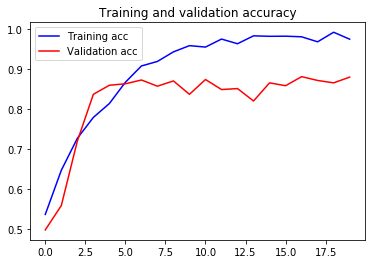

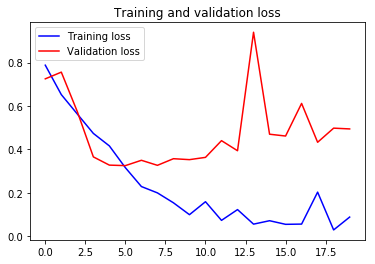

In [0]:
# No Data augmentation 
train_datagen = ImageDataGenerator(rescale=1./255)
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('last7_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 838 images belonging to 2 classes.
84/83 [==============================] - 14s 165ms/step
No of errors = 100/838


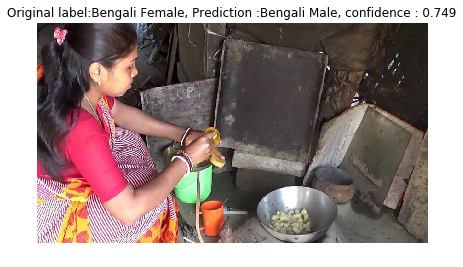

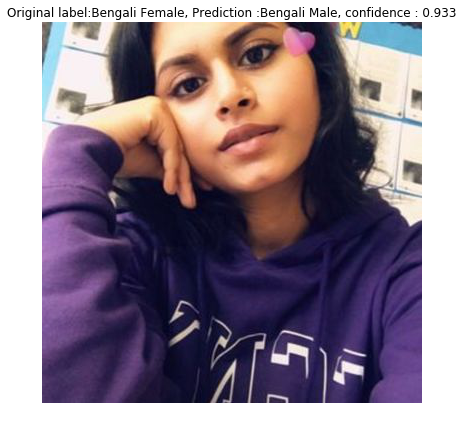

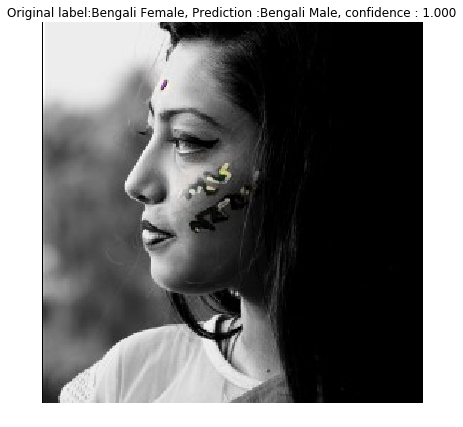

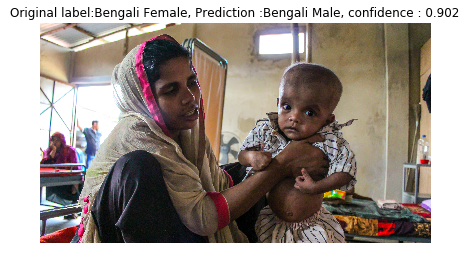

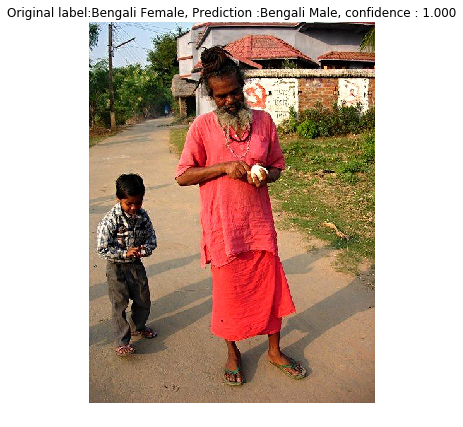

...

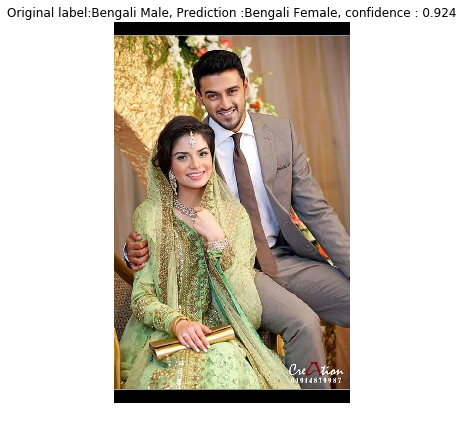

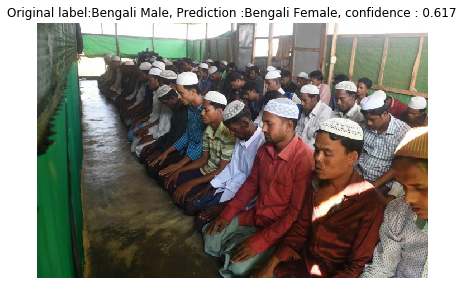

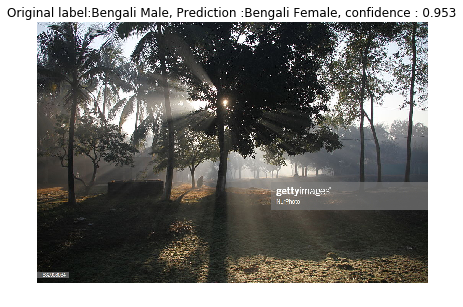

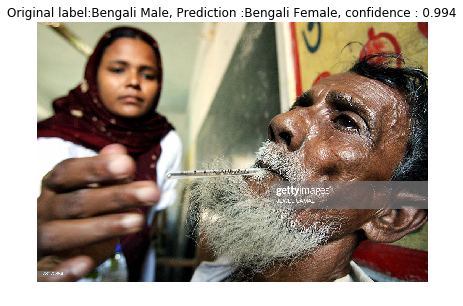

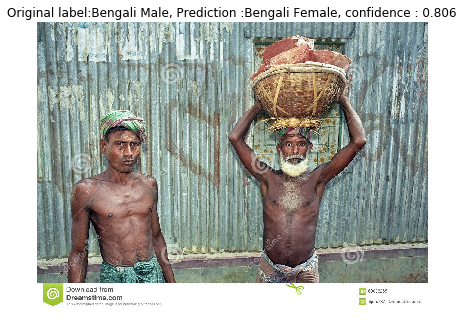

In [0]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

In [0]:
# Experiment 3 : Train last 4 layers with data augmentation




from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-4]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(2, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.input_layer.InputLayer object at 0x7fb8e6bc6f98> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6bc6ef0> False
<keras.layers.convolutional.Conv2D object at 0x7fb8cdc53e80> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8ca51c160> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e6bcf048> False
<keras.layers.convolutional.Conv2D object at 0x7fb8ca501f60> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8ca773a58> False
<keras.layers.convolutional.Conv2D object at 0x7fb8ca773710> False
<keras.layers.convolutional.Conv2D object at 0x7fb8ca73fd68> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e63eb278> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e641edd8> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e641eb38> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e660ba90> False
<keras.layers.convolutional.Conv2D object at 0x7fb8e65f5908> False
<keras.layers.pooling.MaxPooling2D object at 0x7fb8e65a0cf8>

Found 3345 images belonging to 2 classes.
Found 838 images belonging to 2 classes.
Epoch 1/40
  7/133 [>.............................] - ETA: 3:38 - loss: 1.4616 - acc: 0.4571

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:2496: DecompressionBombWarning: Image size (139489119 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning)


 13/133 [=>............................] - ETA: 3:36 - loss: 1.1259 - acc: 0.4800

/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 33685504 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 47185920 bytes but only got 0. Skipping tag 4
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 65536 bytes but only got 0. Skipping tag 3
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to read 2359296 bytes but only got 0. Skipping tag 5
  " Skipping tag %s" % (size, len(data), tag))
/usr/local/lib/python3.6/dist-packages/PIL/TiffImagePlugin.py:725: UserWarning: Possibly corrupt EXIF data.  Expecting to re

134/133 [==============================] - 208s 2s/step - loss: 0.6290 - acc: 0.6813 - val_loss: 0.3481 - val_acc: 0.8663
Epoch 2/40
134/133 [==============================] - 194s 1s/step - loss: 0.3993 - acc: 0.8274 - val_loss: 0.2564 - val_acc: 0.9117
Epoch 3/40
134/133 [==============================] - 193s 1s/step - loss: 0.3067 - acc: 0.8713 - val_loss: 0.2401 - val_acc: 0.9057
Epoch 4/40
134/133 [==============================] - 192s 1s/step - loss: 0.2584 - acc: 0.8937 - val_loss: 0.2637 - val_acc: 0.9045
Epoch 5/40
134/133 [==============================] - 191s 1s/step - loss: 0.2300 - acc: 0.9127 - val_loss: 0.2749 - val_acc: 0.8950
Epoch 6/40
134/133 [==============================] - 192s 1s/step - loss: 0.1984 - acc: 0.9230 - val_loss: 0.3429 - val_acc: 0.9045
Epoch 7/40
134/133 [==============================] - 191s 1s/step - loss: 0.1752 - acc: 0.9316 - val_loss: 0.3697 - val_acc: 0.8950
Epoch 8/40
134/133 [==============================] - 190s 1s/step - loss: 0.162

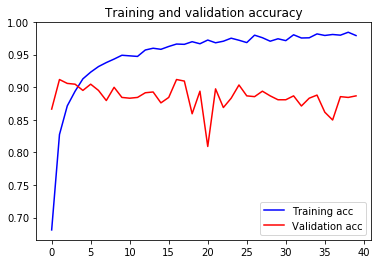

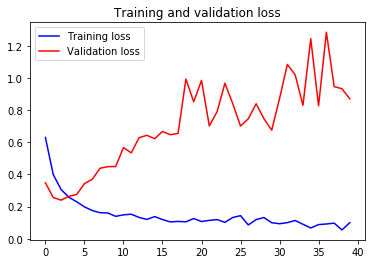

In [0]:

# Experiment 3

# Train the model. Here we will be using the imageDataGenerator for data augmentation.





train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=20,
      width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 50
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=40,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('da_last4_layers.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 838 images belonging to 2 classes.
84/83 [==============================] - 14s 164ms/step
No of errors = 95/838


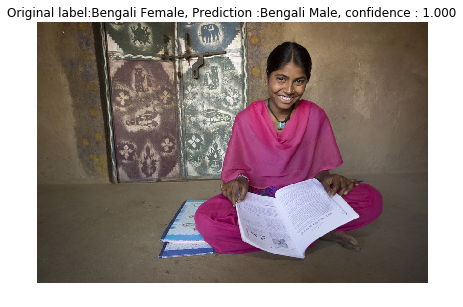

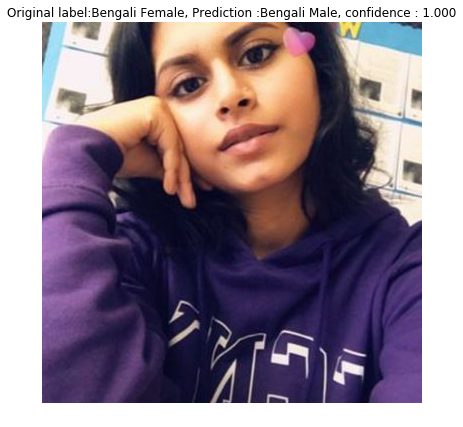

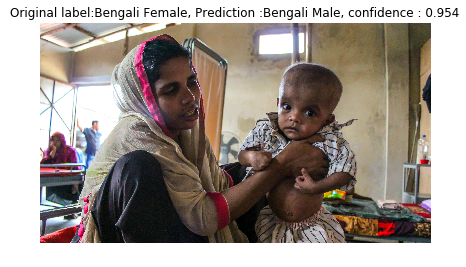

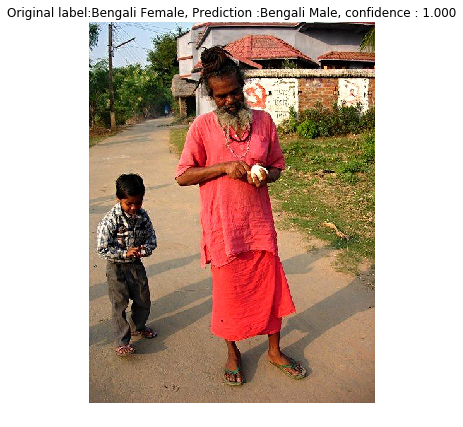

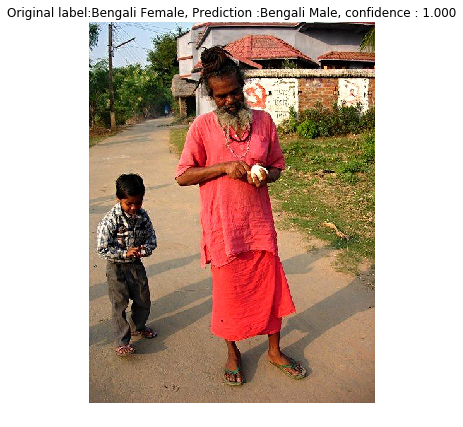

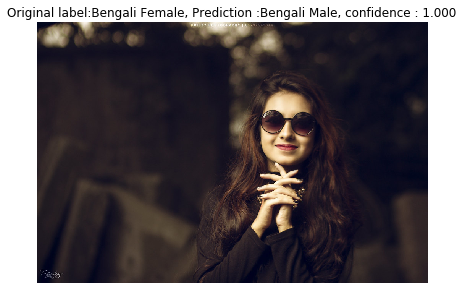

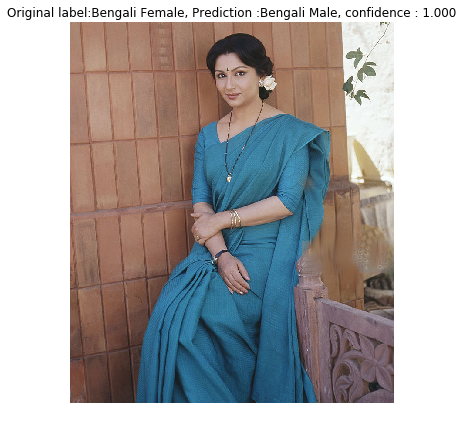

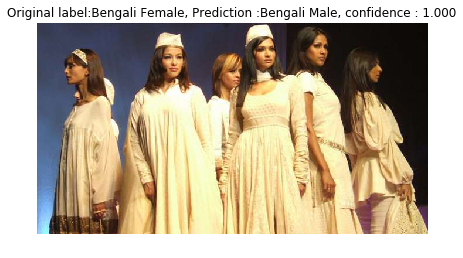

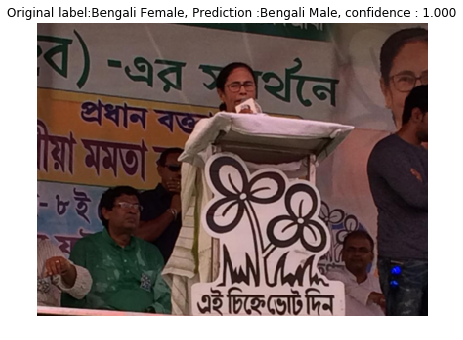

In [0]:
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()